In [1]:
# pip install seaborn matplotlib pandas numpy

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

In [3]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')

print('Train')
rows,columns = train.shape
print(f'Rows: {rows}\nColumns: {columns}\n')


print('Test')
rows,columns = test.shape
print(f'Rows: {rows}\nColumns: {columns}')

Train
Rows: 1235
Columns: 29

Test
Rows: 824
Columns: 28


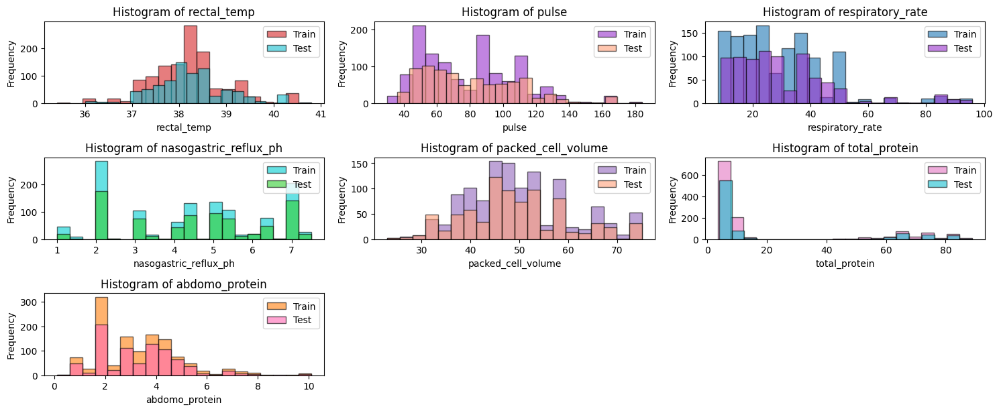

In [4]:
c = 1
plt.figure(figsize=(15, 20))

colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', 
          '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf', 
          '#ffa07a', '#32cd32', '#ff69b4', '#00ced1', '#9932cc']

for i, col in enumerate(test.select_dtypes(float).columns):
    plt.subplot(10, 3, c)
    x= np.random.randint(0,len(colors))
    y=np.random.randint(0,len(colors))
    plt.hist(train[col], bins=20, color=colors[x], alpha=0.6, label='Train', edgecolor='black')
    plt.hist(test[col], bins=20, color=colors[y], alpha=0.6, label='Test', edgecolor='black')
    
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.title(f'Histogram of {col}')
    
    plt.legend(loc='upper right')
    
    c += 1

plt.tight_layout()
plt.show()


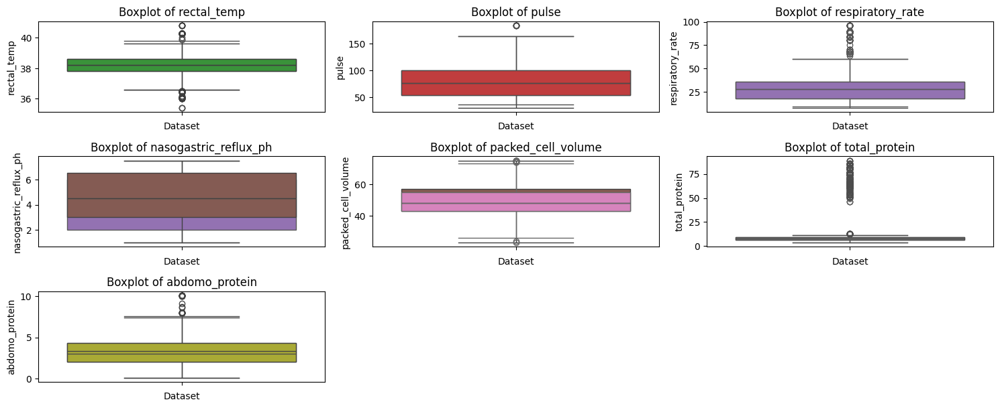

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(15, 20))

colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', 
          '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf', 
          '#ffa07a', '#32cd32', '#ff69b4', '#00ced1', '#9932cc']

num_colors = len(colors)

c = 1
for i, col in enumerate(test.select_dtypes(float).columns):
    plt.subplot(10, 3, c)
    
    train_color = colors[c % num_colors]
    test_color = colors[(c + 1) % num_colors]
    
    sns.boxplot(data=train[col], color=train_color)
    sns.boxplot(data=test[col], color=test_color)
    
    plt.xlabel('Dataset')
    plt.ylabel(col)
    plt.title(f'Boxplot of {col}')
    
    c += 1

plt.tight_layout()
plt.show()


In [6]:
describe = train.describe(include='all')
describe.fillna('-')

,id,surgery,age,hospital_number,rectal_temp,pulse,respiratory_rate,temp_of_extremities,peripheral_pulse,mucous_membrane,...,packed_cell_volume,total_protein,abdomo_appearance,abdomo_protein,surgical_lesion,lesion_1,lesion_2,lesion_3,cp_data,outcome
count,1235.0,1235,1235,1235.0,1235.0,1235.0,1235.0,1235,1235,1235,...,1235.0,1235.0,1235,1235.0,1235,1235.0,1235.0,1235.0,1235,1235
unique,-,2,2,-,-,-,-,5,5,7,...,-,-,4,-,2,-,-,-,2,3
top,-,yes,adult,-,-,-,-,cool,reduced,pale_pink,...,-,-,serosanguious,-,yes,-,-,-,yes,lived
freq,-,887,1160,-,-,-,-,700,724,284,...,-,-,570,-,929,-,-,-,668,574
mean,617.0,-,-,954500.401619,38.202186,79.574089,30.054251,-,-,-,...,49.602429,21.388016,-,3.290931,-,3832.496356,14.612146,3.577328,-,-
std,356.6581,-,-,1356403.13894,0.788668,29.108638,16.452066,-,-,-,...,10.5358,26.676453,-,1.589195,-,5436.733774,193.705735,88.858953,-,-
min,0.0,-,-,521399.0,35.4,30.0,8.0,-,-,-,...,23.0,3.5,-,0.1,-,0.0,0.0,0.0,-,-
25%,308.5,-,-,528800.0,37.8,53.0,18.0,-,-,-,...,43.0,6.6,-,2.0,-,2205.0,0.0,0.0,-,-
50%,617.0,-,-,529777.0,38.2,76.0,28.0,-,-,-,...,48.0,7.5,-,3.0,-,2209.0,0.0,0.0,-,-
75%,925.5,-,-,534145.0,38.6,100.0,36.0,-,-,-,...,57.0,9.1,-,4.3,-,3205.0,0.0,0.0,-,-


In [7]:
describe.dtypes

id                       float64
surgery                   object
age                       object
hospital_number          float64
rectal_temp              float64
pulse                    float64
respiratory_rate         float64
temp_of_extremities       object
peripheral_pulse          object
mucous_membrane           object
capillary_refill_time     object
pain                      object
peristalsis               object
abdominal_distention      object
nasogastric_tube          object
nasogastric_reflux        object
nasogastric_reflux_ph    float64
rectal_exam_feces         object
abdomen                   object
packed_cell_volume       float64
total_protein            float64
abdomo_appearance         object
abdomo_protein           float64
surgical_lesion           object
lesion_1                 float64
lesion_2                 float64
lesion_3                 float64
cp_data                   object
outcome                   object
dtype: object

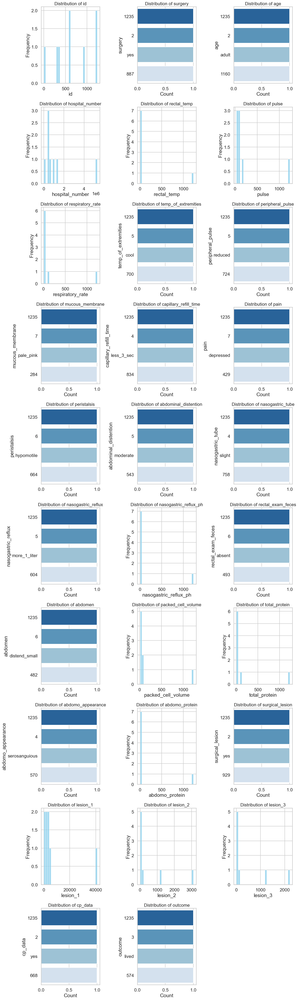

In [8]:
sns.set(style="whitegrid", context="talk")

num_columns = len(train.columns)
num_rows = int(np.ceil(num_columns / 3))

plt.figure(figsize=(15, num_rows * 5))

for index, column in enumerate(train.columns):
    val = describe[column].dropna()
    dtype = val.dtype
    
    plt.subplot(num_rows, 3, index + 1)
    
    if np.issubdtype(dtype, np.number):
        sns.histplot(val, kde=False, color='skyblue', bins=30)
        plt.xlabel(column)
        plt.ylabel('Frequency')
    else:
        order = val.value_counts().index
        sns.countplot(y=val, order=order, palette='Blues_r')
        plt.xlabel('Count')
        plt.ylabel(column)
    
    plt.title(f'Distribution of {column}', fontsize=16)

plt.tight_layout()
plt.show()

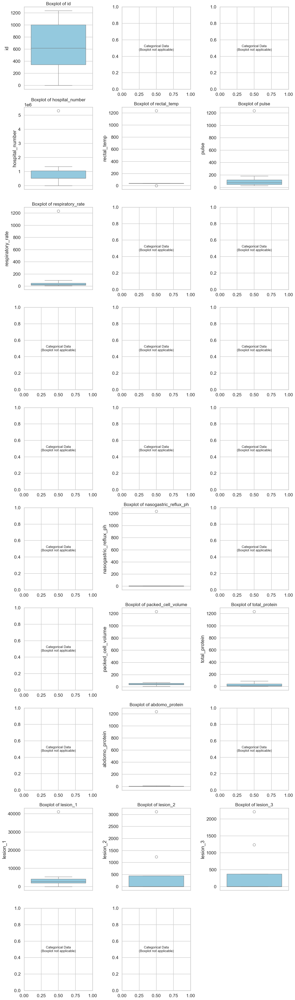

In [9]:
sns.set(style="whitegrid", context="talk")

num_columns = len(train.columns)
num_rows = int(np.ceil(num_columns / 3))

plt.figure(figsize=(15, num_rows * 5))

for index, column in enumerate(train.columns):
    val = describe[column].dropna()
    dtype = val.dtype
    
    plt.subplot(num_rows, 3, index + 1)
    
    if np.issubdtype(dtype, np.number):
        sns.boxplot(y=val, color='skyblue')
        plt.xlabel('')
        plt.ylabel(column)
        plt.title(f'Boxplot of {column}', fontsize=16)
    else:
        plt.text(0.5, 0.5, 'Categorical Data\n(Boxplot not applicable)',
                 horizontalalignment='center', verticalalignment='center',
                 fontsize=12, transform=plt.gca().transAxes)
    
plt.tight_layout()
plt.show()

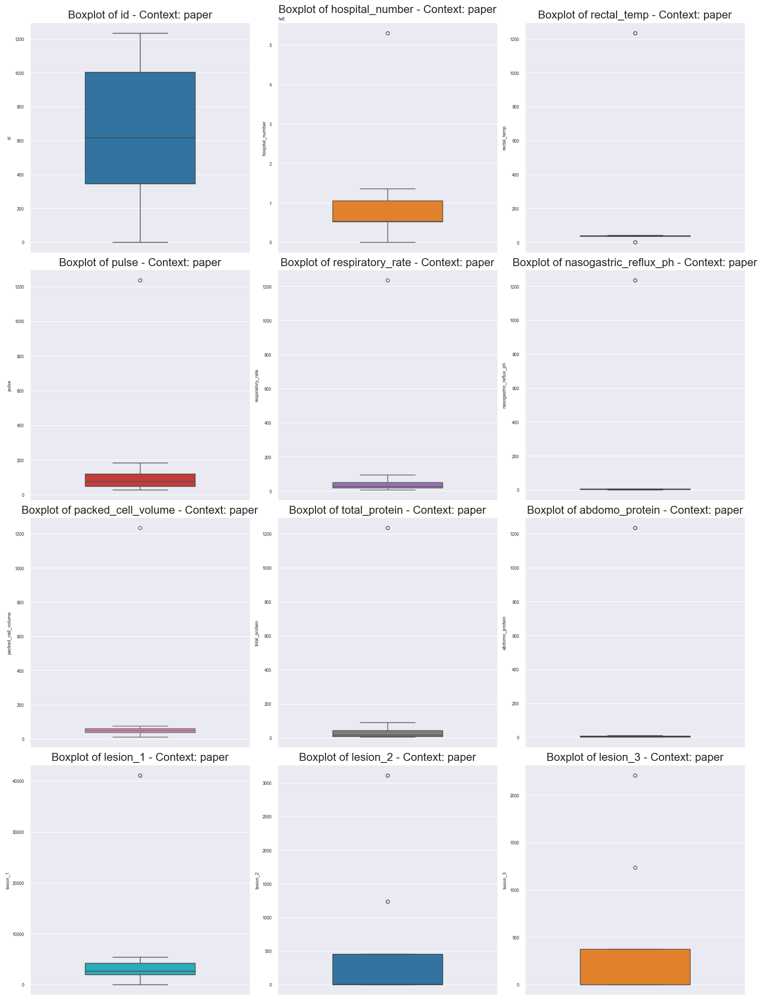

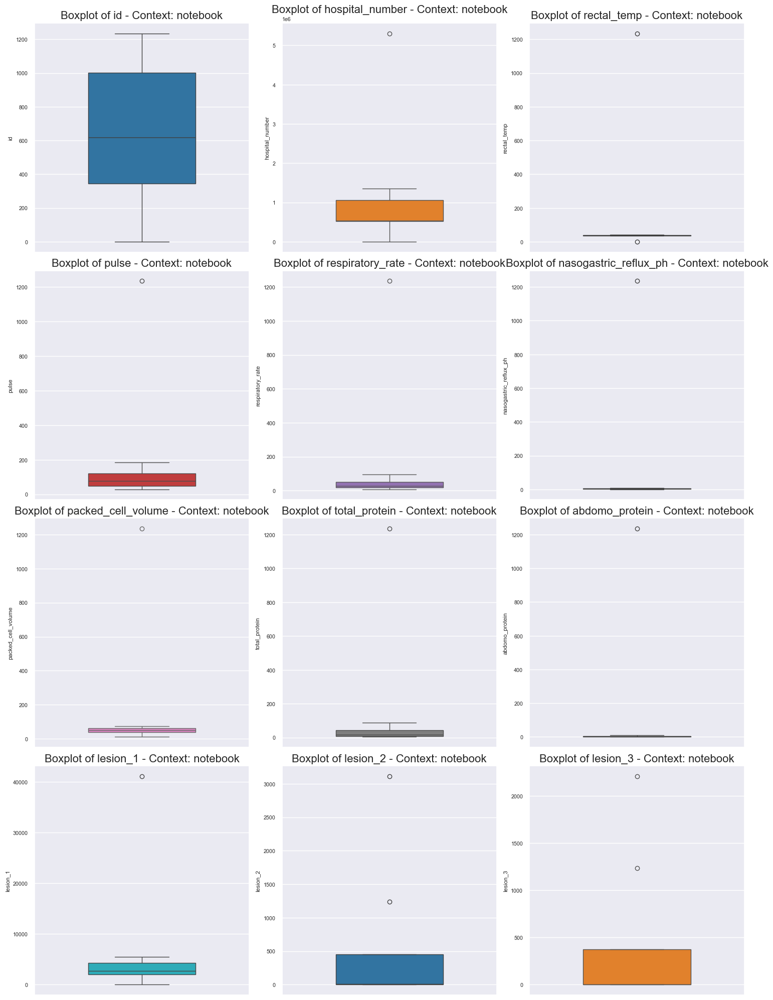

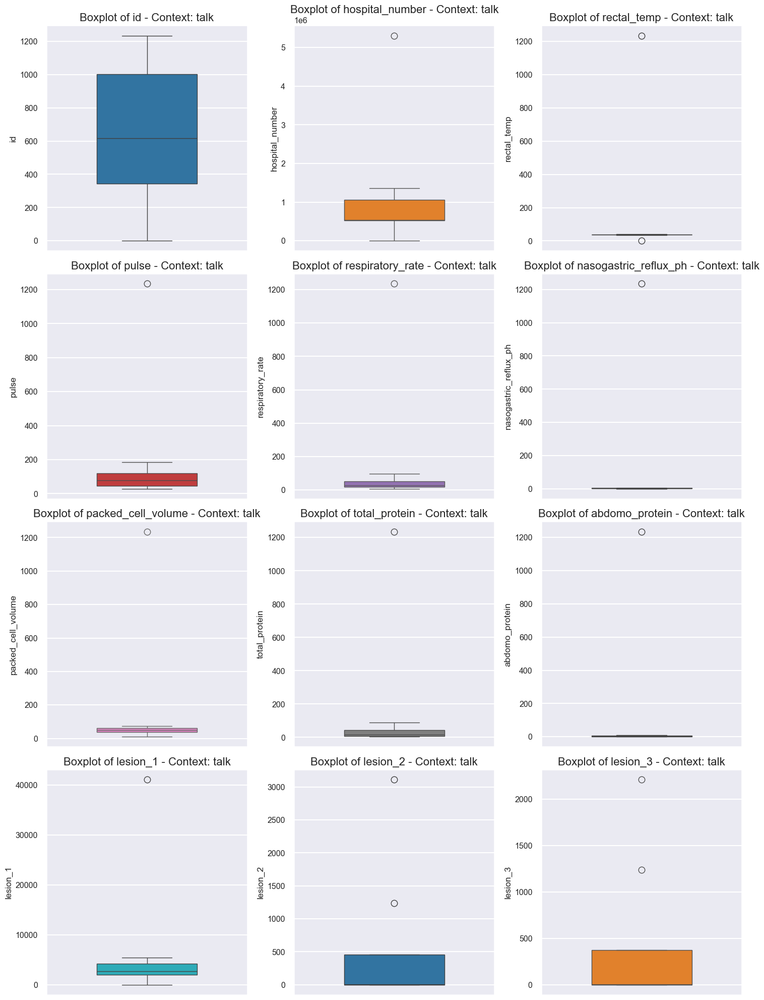

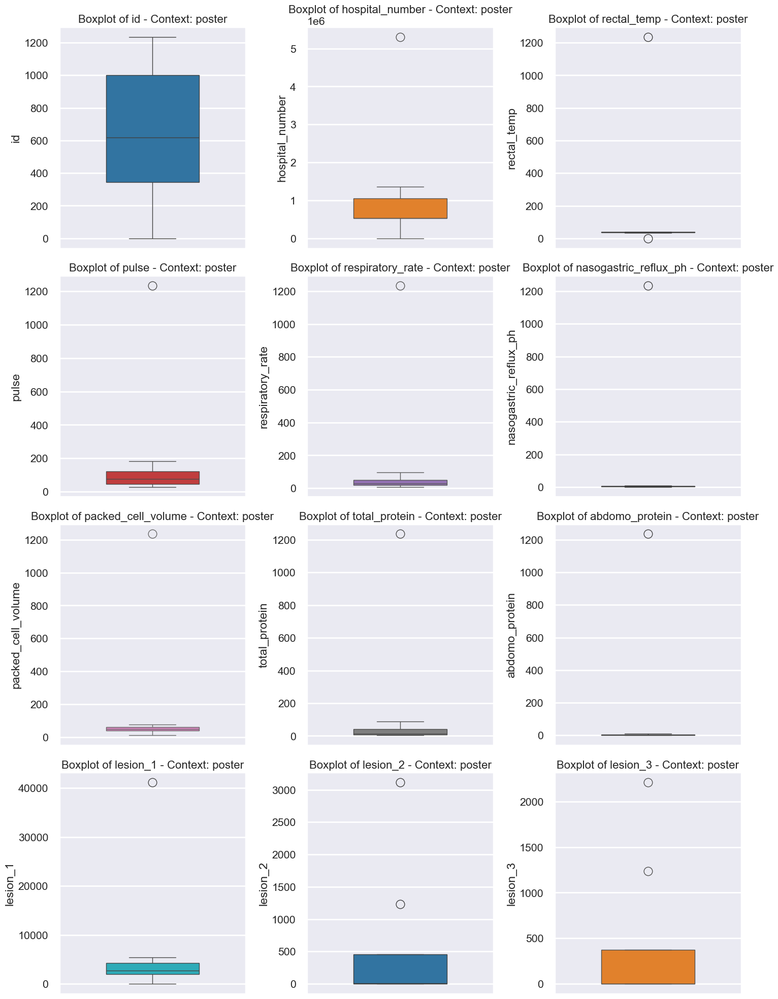

In [10]:
contexts = ["paper", "notebook", "talk", "poster"]

for context in contexts:
    sns.set(style="darkgrid", context=context, font_scale=.7)

    numeric_cols = describe.select_dtypes(include=[np.number]).columns

    num_columns = len(numeric_cols)
    num_rows = int(np.ceil(num_columns / 3))

    plt.figure(figsize=(15, num_rows * 5))

    for index, column in enumerate(numeric_cols):
        val = describe[column].dropna()
    
        plt.subplot(num_rows, 3, index + 1)
        sns.boxplot(y=val, color=sns.color_palette("tab10", 10)[index % 10], width=0.5)
        plt.title(f'Boxplot of {column} - Context: {context}', fontsize=16)

    plt.tight_layout()
    plt.show()

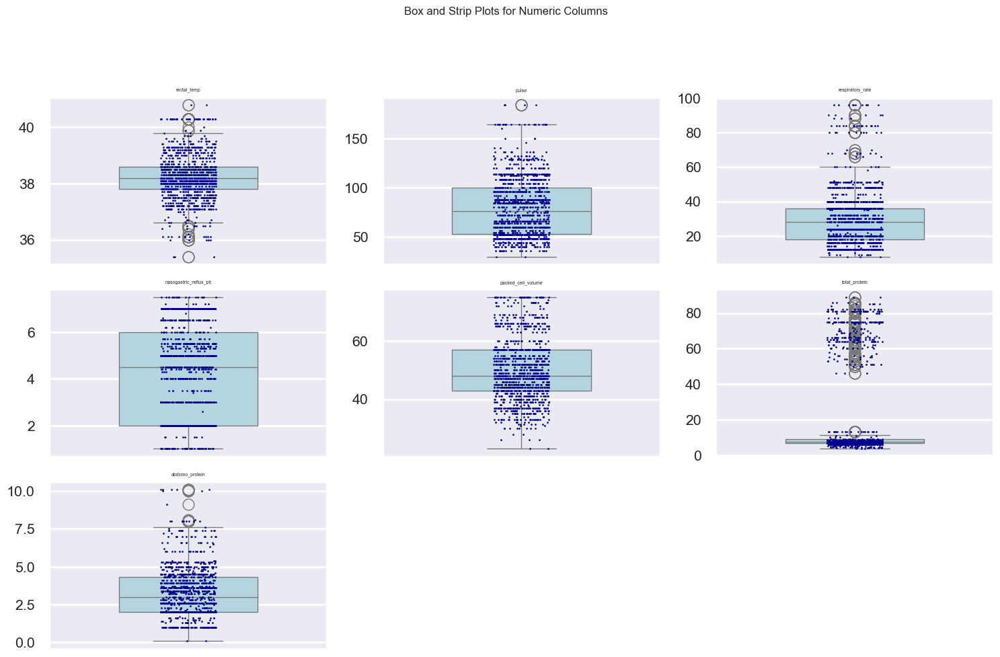

In [11]:
plt.figure(figsize=(15, 45))  

c = 1
for index, column in enumerate(train.columns):
    val = train[column].dropna()
    type = val.dtype
    
    if type == 'float64':
        plt.subplot(15, 3, c)
        sns.boxplot(y=val, color='lightblue', width=0.5)
        sns.stripplot(y=val, color='darkblue', jitter=True, size=2)
        plt.title(column, fontsize=5)  
        plt.xlabel('', fontsize=10) 
        plt.ylabel('',fontsize=5)
        plt.xticks(fontsize=5)
        c += 1

plt.suptitle('Box and Strip Plots for Numeric Columns', fontsize=12)  
plt.tight_layout()
plt.subplots_adjust(top=0.95)  
plt.show()

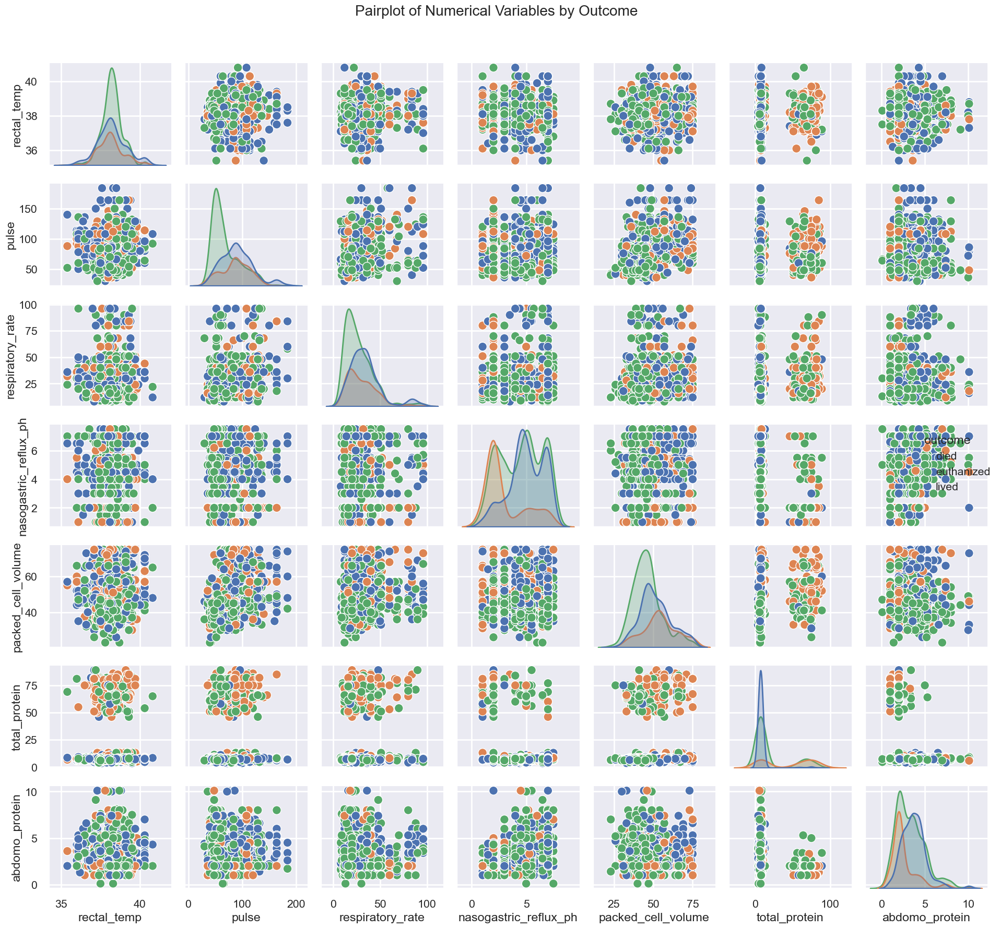

In [12]:
numerical_cols = train.select_dtypes(include='float64').columns
sns.pairplot(train[numerical_cols].join(train['outcome']), hue='outcome', diag_kind='kde')
plt.suptitle('Pairplot of Numerical Variables by Outcome', y=1.02)
plt.xlabel('',rotation=45)
plt.tight_layout()
plt.show()

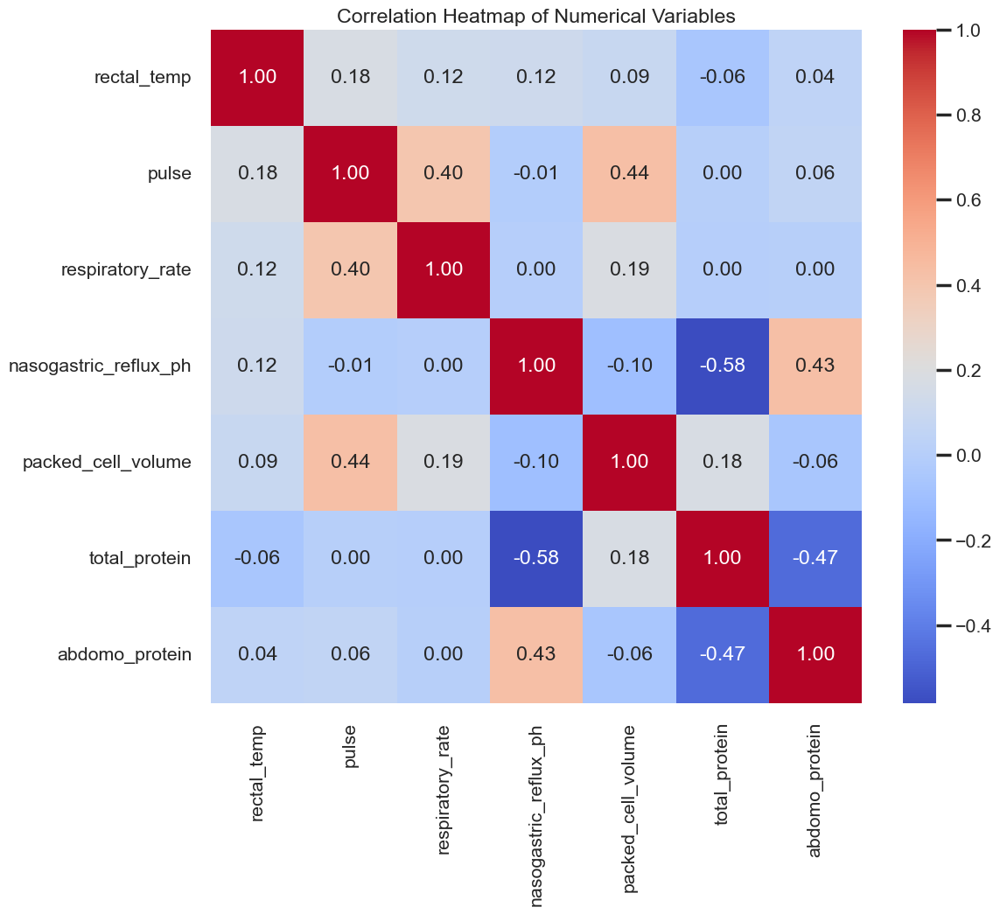

In [13]:
correlation_matrix = train[numerical_cols].corr()
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, fmt='.2f', cmap='coolwarm')
plt.title('Correlation Heatmap of Numerical Variables')
plt.show()

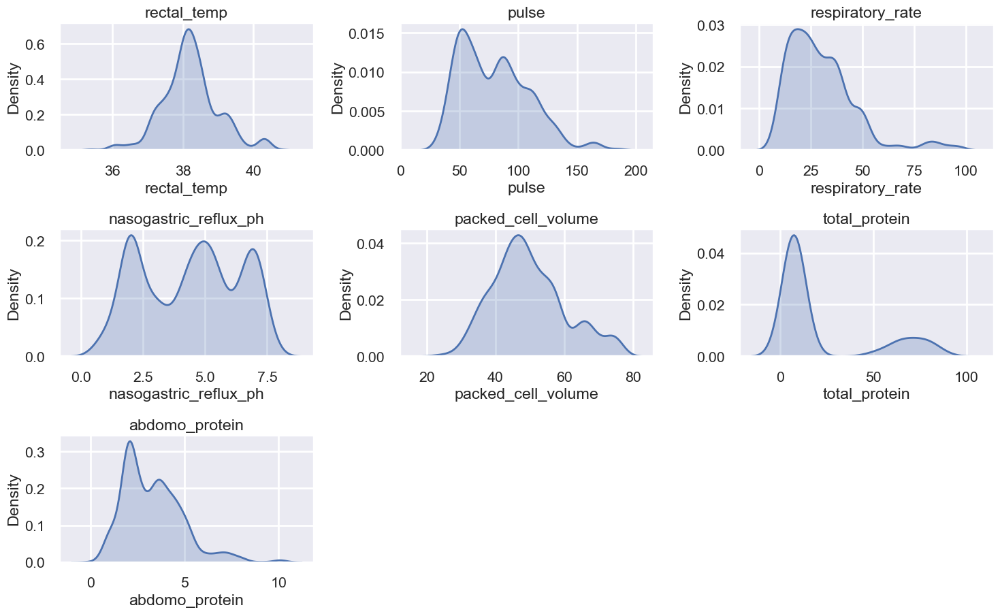

In [14]:
plt.figure(figsize=(15, 45))

for index, column in enumerate(train.select_dtypes(include='float64').columns):
    plt.subplot(15, 3, index + 1)
    sns.kdeplot(data=train, x=column, fill=True)
    plt.title(column)

plt.tight_layout()
plt.show()

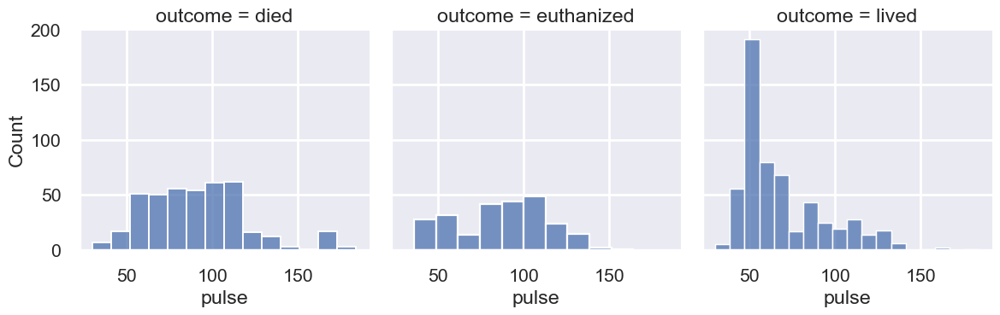

In [15]:
g = sns.FacetGrid(train, col="outcome", col_wrap=3, height=4)
g.map_dataframe(sns.histplot, x="pulse")
plt.show()

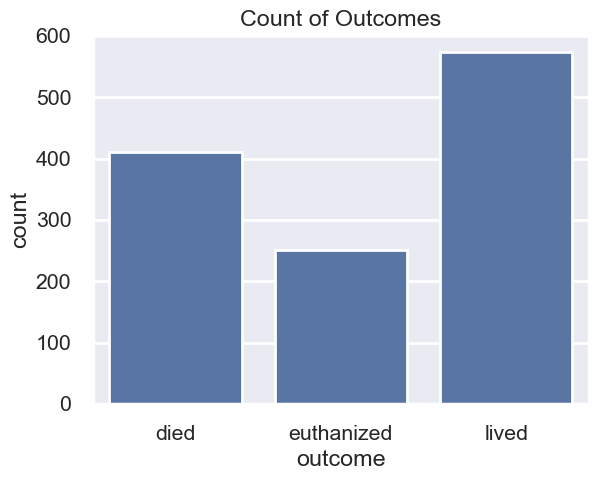

In [16]:
sns.countplot(x='outcome', data=train)
plt.title('Count of Outcomes')
plt.show()


In [17]:
numerical_cols = train.select_dtypes(include='float64').columns
n = len(numerical_cols)
fig, axs = plt.subplots(n, n, figsize=(150, 150))

for i, col1 in enumerate(numerical_cols):
    for j, col2 in enumerate(numerical_cols):
        if col1 != col2:  
            sns.scatterplot(x=train[col1], y=train[col2], ax=axs[i, j], hue=train['outcome'], legend=False)
            axs[i, j].set_title(f'{col1} vs {col2}')

for i in range(n):
    axs[i, i].axis('off')

plt.tight_layout()
plt.show()


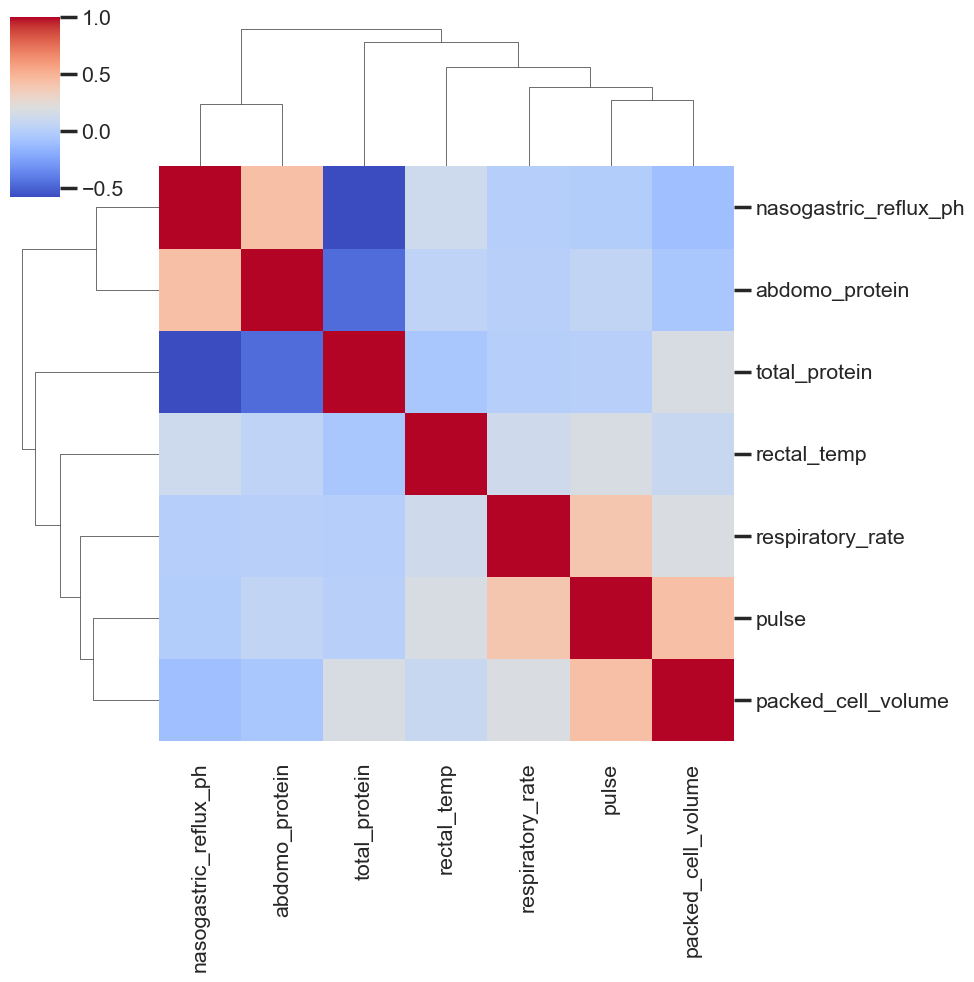

In [18]:
sns.clustermap(correlation_matrix, method='average', cmap='coolwarm', figsize=(10, 10))
plt.show()

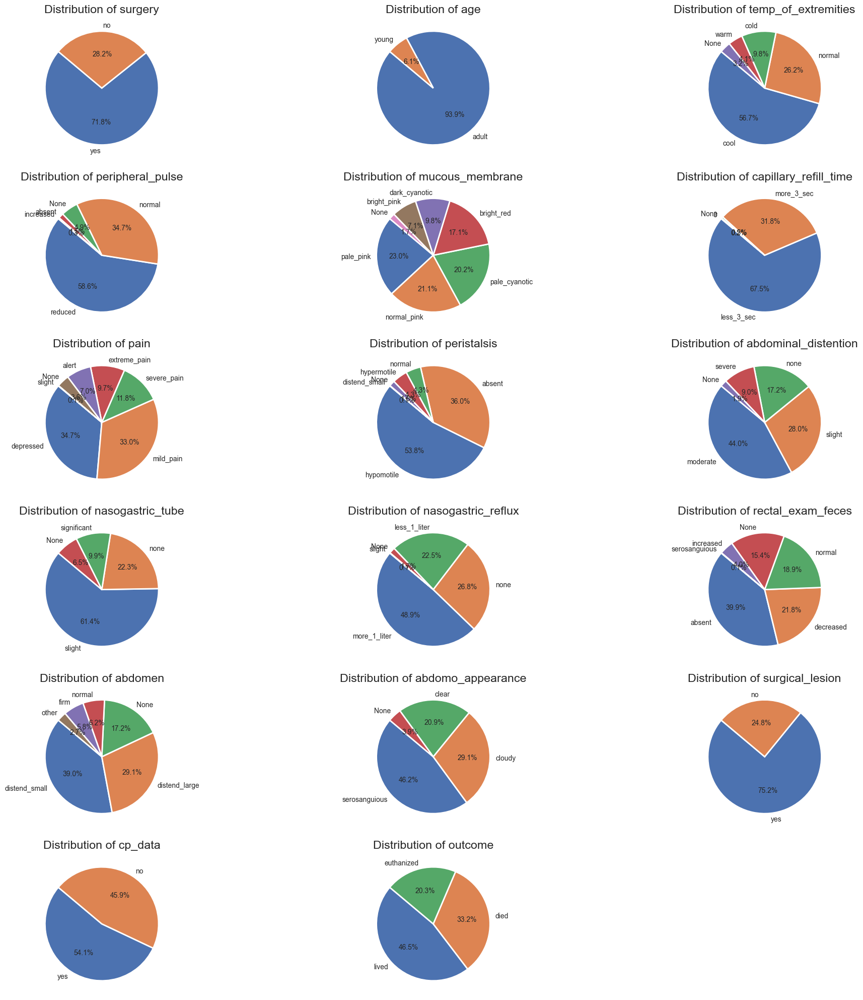

In [19]:
obj = train.select_dtypes('object')
plt.figure(figsize=(20, 50))

c=1
for column in obj.columns:
    plt.subplot(15,3,c)
    train[column].value_counts().plot.pie(autopct='%1.1f%%', startangle=140,fontsize=10)
    plt.title(f'Distribution of {column}')
    plt.ylabel('')  
    c+=1
    
plt.tight_layout()
plt.show()


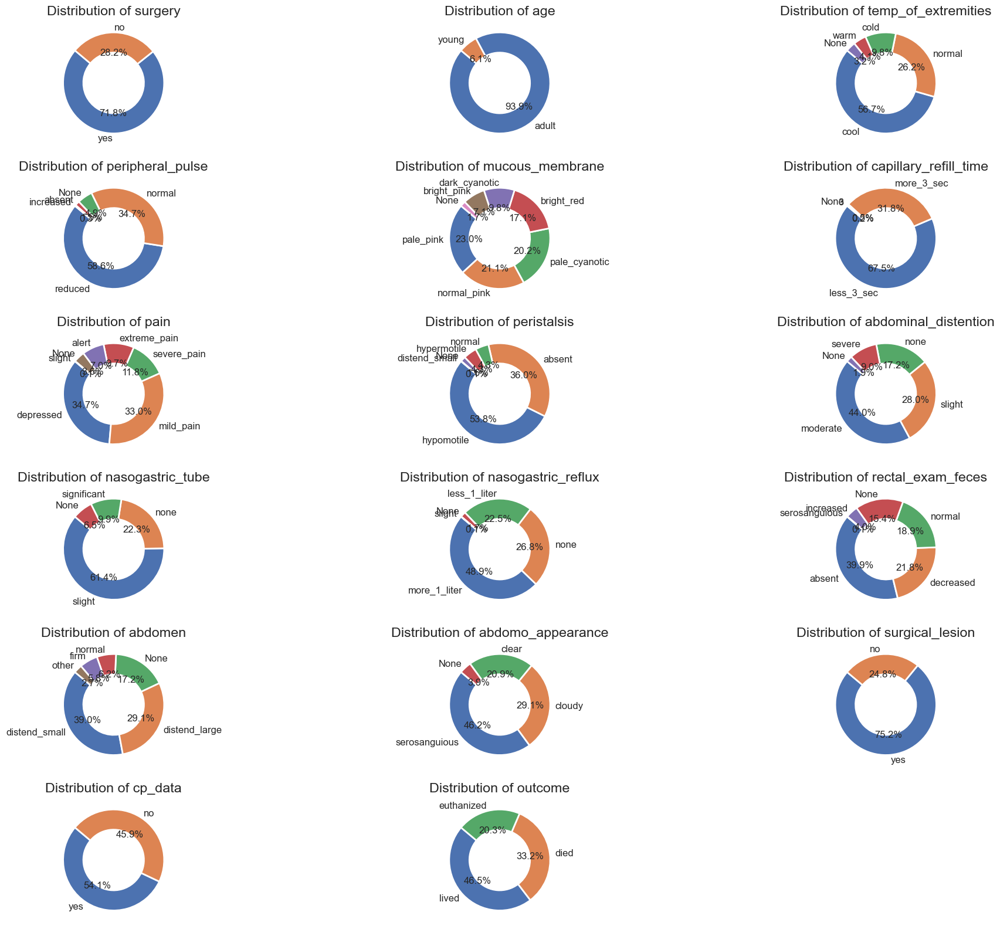

In [20]:
obj = train.select_dtypes('object')
plt.figure(figsize=(20, 40))  

c = 1
for column in obj.columns:
    plt.subplot(15, 3, c)
    train[column].value_counts().plot.pie(autopct='%1.1f%%', startangle=140, fontsize=12,
                                           wedgeprops=dict(width=0.4))  
    plt.title(f'Distribution of {column}')
    plt.ylabel('')  
    c += 1
    
plt.tight_layout()
plt.show()

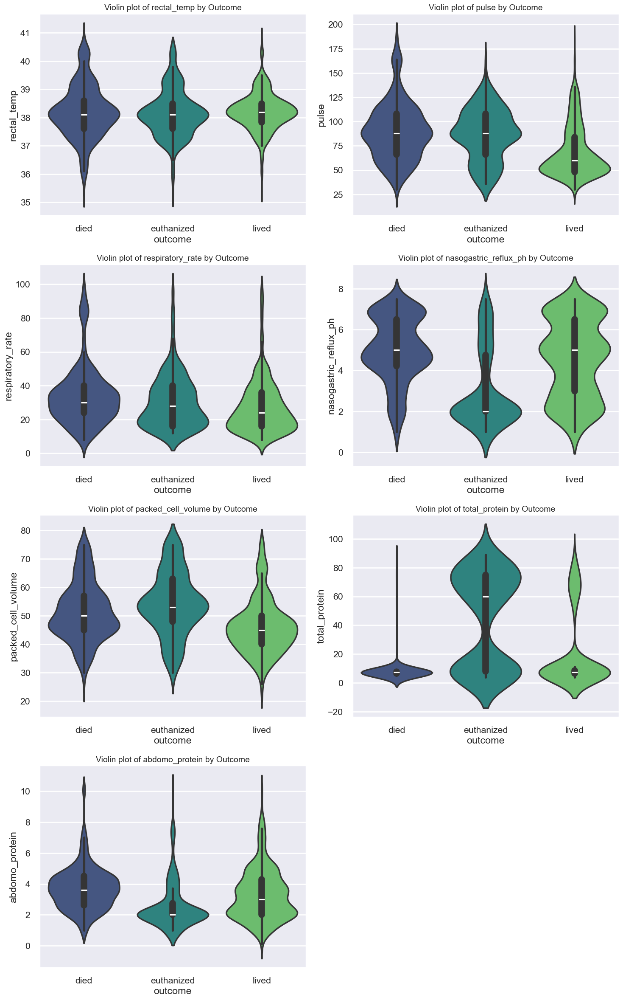

In [21]:
numerical_cols = train.select_dtypes('float64').columns

plt.figure(figsize=(15, 35))

for idx, col in enumerate(numerical_cols, 1):
    plt.subplot(6, 2, idx)  
    sns.violinplot(x='outcome', y=col, data=train, palette='viridis')
    plt.title(f'Violin plot of {col} by Outcome',fontsize=14)

plt.tight_layout()
plt.show()

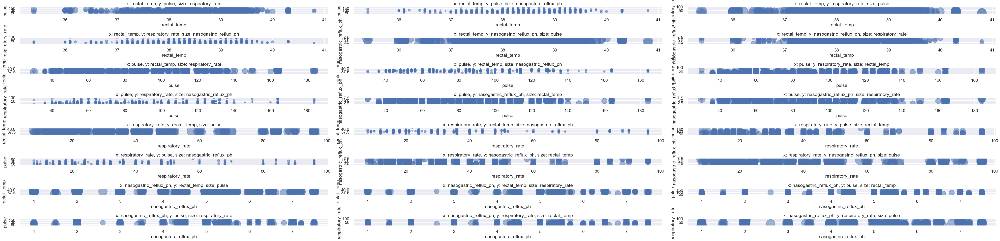

In [22]:
numerical_cols = train.select_dtypes(include='float64').columns[:4]

plt.figure(figsize=(50, 150))
plot_number = 1

for col1 in numerical_cols:
    for col2 in numerical_cols:
        for col3 in numerical_cols:
            if col1 != col2 and col1 != col3 and col2 != col3:
                plt.subplot(100, 3, plot_number)
                x = train[col1]
                y = train[col2]
                size = train[col3]
                plt.scatter(x, y, s=size*10, alpha=0.5) 
                plt.title(f'x: {col1}, y: {col2}, size: {col3}')
                plt.xlabel(col1)
                plt.ylabel(col2)
                plot_number += 1
                # plt.show()

plt.tight_layout()
plt.show()


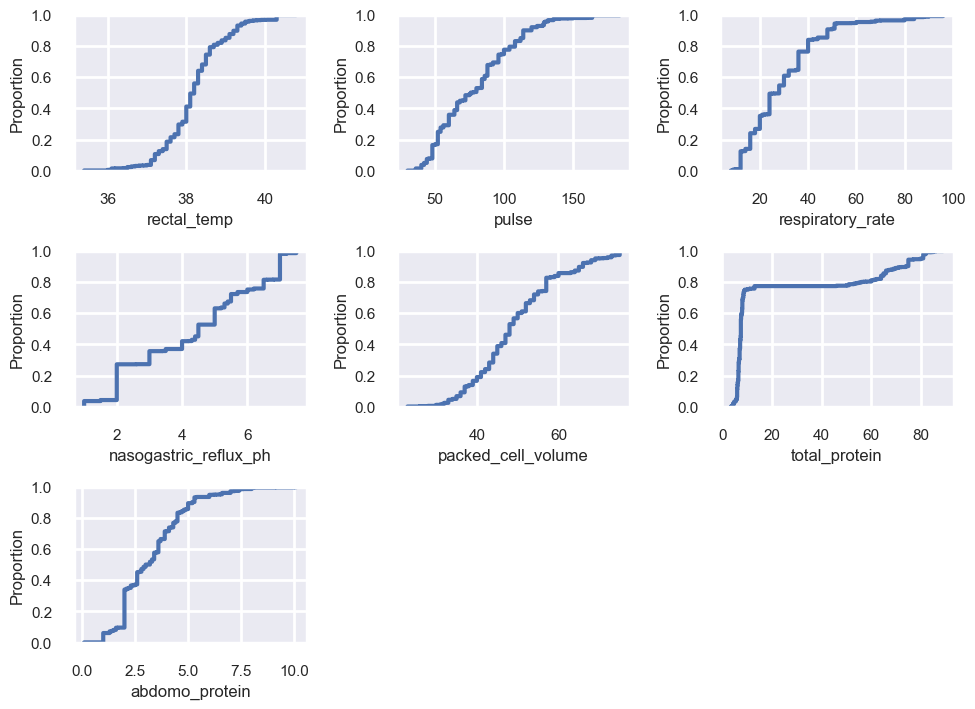

In [23]:
plt.rcParams.update({'font.size': 8})
plt.figure(figsize=(10, 35))
sns.set(style="darkgrid", context=context, font_scale=.5)

c = 1
for column in train.select_dtypes(include='float64').columns:
    plt.subplot(15, 3, c)
    sns.ecdfplot(data=train, x=column)
    c += 1
        
plt.tight_layout()
plt.show()
